## Setup

Below scripts are used to generate data for analysing data for the custom html pre-processing loading and splitter coding changes

In [1]:
pip install --index-url https://pypi.it.att.com langchain tiktoken seaborn tqdm datasets num2words matplotlib plotly scipy scikit-learn pandas numpy azure-search-documents azure-identity matplotlib seaborn

Looking in indexes: https://pypi.it.att.com
Note: you may need to restart the kernel to use updated packages.


You should consider upgrading via the 'c:\Users\of5253\AppData\Local\Programs\Python\Python310\python.exe -m pip install --upgrade pip' command.


## Analyzing Chunk Size

In [2]:
index_name = 'c-care-cog-no-separators-dev-2023-11-16'

import json
from dotenv import load_dotenv
from azure.core.credentials import AzureKeyCredential
from azure.search.documents.indexes import SearchIndexClient
import os

load_dotenv('./.env')

endpoint = os.environ.get('AZURE_AI_SEARCH_ENDPOINT')
key = os.environ.get('AZURE_AI_SEARCH_API_KEY')

credential = AzureKeyCredential(key)
search_index = SearchIndexClient(endpoint=endpoint, credential=credential)

_SELECT_FIELDS = [
    'id',
    'content',
    'source'
]

search_client = search_index.get_search_client(index_name)
documents = search_client.search(
    search_text="",
    select=_SELECT_FIELDS
)

INPUT_PATH = "./output-raw.json"

with open(INPUT_PATH, 'w') as f:
    json.dump([document for document in documents], f)

C:\Users\of5253\AppData\Roaming\Python\Python310\site-packages\requests\__init__.py:102: RequestsDependencyWarning: urllib3 (1.26.17) or chardet (5.2.0)/charset_normalizer (2.0.12) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({})/charset_normalizer ({}) doesn't match a supported "


Below script helps get the counts of the chunk size to analyse the data visually later.

In [3]:
import numpy as np
from tqdm import tqdm
import json

with open('output-raw.json', 'r') as f:
    data = json.load(f)

cnt_list = {}

# Loop through the data and print the 'content' value for each item
for item in tqdm(data):
    cnt_size = len(item['content'])
    cnt_list[item['id']] = cnt_size

max_chunk_size = np.max(list(cnt_list.values()))
print(f"Max chunk size - {max_chunk_size}")

min_chunk_size = np.min(list(cnt_list.values()))
print(f"Min chunk size - {min_chunk_size}")

median_chunk_size = np.median(list(cnt_list.values()))
print(f"Median of chunk size - {median_chunk_size}")

avg_chunk_size = np.mean(list(cnt_list.values()))
print(f"Avg of chunk size- {avg_chunk_size}")

100%|██████████| 10678/10678 [00:00<00:00, 1045125.85it/s]

Max chunk size - 239114
Min chunk size - 1
Median of chunk size - 931.0
Avg of chunk size- 2771.251357932197


### Histograms for visualization

Histogram to demonstrate the chunk size distribution in the ACS index data for a given configuration.

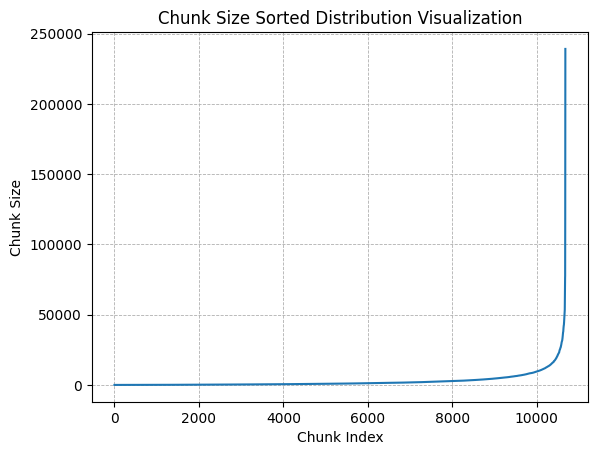

In [4]:
import matplotlib.pyplot as plt

# Assuming token_size is your list
token_size = list(cnt_list.values())
token_size.sort()

# plt.figure(figsize=(10,5))

# Create a plot chart
plt.plot(token_size)

plt.title('Chunk Size Sorted Distribution Visualization')
plt.xlabel('Chunk Index')
plt.ylabel('Chunk Size')

plt.grid(True, linestyle='--', linewidth=0.6)

# Display the plot
plt.show()

Histogram to demonstrate the chunk size frequency in the ACS index data for a given configuration.

<Figure size 2000x500 with 0 Axes>

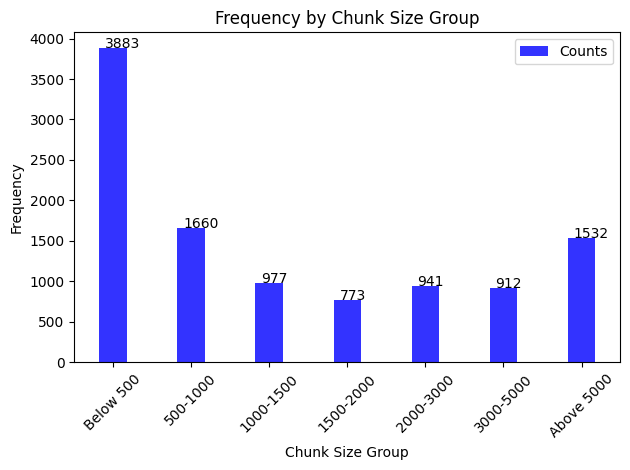

In [5]:
import matplotlib.pyplot as plt

# assuming token_size is your list
token_size = list(cnt_list.values())

# count the number of items below and above 1500
# count the number of items in each group
group1 = len([i for i in token_size if i < 500])
group2 = len([i for i in token_size if 500 <= i < 1000])
group3 = len([i for i in token_size if 1000 <= i < 1500])
group4 = len([i for i in token_size if 1500 <= i < 2000])
group5 = len([i for i in token_size if 2000 <= i < 3000])
group6 = len([i for i in token_size if 3000 <= i < 5000])
group7 = len([i for i in token_size if i >= 5000])

plt.figure(figsize=(20, 5))

# data to plot
n_groups = 7
counts = (group1, group2, group3, group4, group5, group6, group7)

# create plot
fig, ax = plt.subplots()
index = range(n_groups)
bar_width = 0.35
opacity = 0.8

rects1 = plt.bar(index, counts, bar_width,
alpha=opacity,
color='b',
label='Counts')

plt.xlabel('Chunk Size Group')
plt.ylabel('Frequency')
plt.title('Frequency by Chunk Size Group')
plt.xticks(index, ('Below 500', '500-1000', '1000-1500', '1500-2000', '2000-3000', '3000-5000', 'Above 5000'), rotation=45)
plt.legend()

for i in range(n_groups):
    plt.text(x = index[i]-0.1 , y = counts[i]+0.1, s = counts[i], size = 10)


plt.tight_layout()
plt.show()

### Find Chunks where Chunk Size is above 1500

Below script helps get data points for chunks above a given limit. This helps understand why some chunks are not split based on the chunk size limit defined in the domain configuration. `CHUNK_SIZE_THRESHOLD` can be updated as needed to get a list of chunks above that threshold, in addition to the article ids.

In [6]:
import numpy as np
from tqdm import tqdm
import json

CHUNK_SIZE_THRESHOLD = 3000

output_filename = f"./output_above_{CHUNK_SIZE_THRESHOLD}.json"
output = []

for item in tqdm(data):
    tkn_cnt = len(item['content'])

    if tkn_cnt > CHUNK_SIZE_THRESHOLD:
        output.append({ "source": item['source'], "token_count": tkn_cnt, "chunk_text": item['content'] })

with open(output_filename, 'w') as f:
    json.dump([output for output in output], f)

print(f"Chunks above chunk size threshold {CHUNK_SIZE_THRESHOLD}: {len(output)}")
print("Output generated in " + output_filename)
print("\n")
print(output)

100%|██████████| 10678/10678 [00:00<00:00, 821429.09it/s]


Chunks above chunk size threshold 3000: 2444
Output generated in ./output_above_3000.json


[{'source': '/app/docstore/care_cog_no_separators/2023-11-16/pending/000023743.json', 'token_count': 22959, 'chunk_text': 'Back out codes   \n "When assisting with returned payment scenarios: Review the customer\'s payment history in ExpressPay to identify which payment has returned. Telegence may incorrectly assign the Reversal Code (Chargeback or Returned Payment) to a payment other than the one that was actually returned. If you are unable to determine the reason for the return based on the Telegence Reversal Codes or Memos, advise the customer to contact their financial institution for assistance.. Reversal Code Description Fee Re-Present1 Process ALPFEE Internal Lockbox Return Yes Depends on the return reason Refer to the account notes and advise of the return reason noted. If no notations, refer to. Suggested Verbiage: Our system shows your financial institution declined the transaction an

### Find Chunks where Chunk Text is repeated

Below script helps get data points for chunks above a given limit. This helps understand why some chunks are not split based on the chunk size limit defined in the domain configuration. `CHUNK_SIZE_THRESHOLD` can be updated as needed to get a list of chunks above that threshold, in addition to the article ids.

In [13]:
import numpy as np
from tqdm import tqdm
import json

output_filename = f"./output_above_repeated_chunk_text.json"
temp = {}
output = []

for item in tqdm(data):

    chunk_text = item['content']

    if not chunk_text in temp:
        temp[chunk_text] = []

    temp[chunk_text].append(item)

for text in temp:
    if len(temp[text]) > 1:
        output.append(temp[text])

with open(output_filename, 'w') as f:
    json.dump([output for output in output], f)

print(f"Repeated chunks: {len(output)}")
print("Output generated in " + output_filename)
print("\n")
print(output)

100%|██████████| 10678/10678 [00:00<00:00, 252196.26it/s]


Repeated chunks: 137
Output generated in ./output_above_repeated_chunk_text.json


[[{'content': 'DETAILS\nTROUBLESHOOTING\nRESOURCES\n \n \n \n AT&T Connected Car', 'id': 'YzVmYzc4ODAtOWFhNC00MDI5LTljODQtODMxZjEzMGFiZmU3', 'source': '/app/docstore/care_cog_no_separators/2023-11-16/pending/000095704.json', '@search.score': 1.0, '@search.reranker_score': None, '@search.highlights': None, '@search.captions': None}, {'content': 'DETAILS\nTROUBLESHOOTING\nRESOURCES\n \n \n \n AT&T Connected Car', 'id': 'Y2VjOGU5ZmEtYTIzZi00OGQ3LWIxMzItY2MxMjBmNGZhMjgw', 'source': '/app/docstore/care_cog_no_separators/2023-11-16/pending/000095703.json', '@search.score': 1.0, '@search.reranker_score': None, '@search.highlights': None, '@search.captions': None}], [{'content': 'Updates/Enhancements \n Device security updates', 'id': 'ZDdiOGQzNzctYTEyMS00MzQyLTgyYzYtMzEwNDAzNGMyOTg5', 'source': '/app/docstore/care_cog_no_separators/2023-11-16/pending/000016876.json', '@search.score': 1.0, '@search.reranker_scor

## Analyzing in_top_init

In [5]:
import pandas as pd
import os

baseline_results = 'baseline.csv'
experiment_results = 'b59b7c75-5675-4fb0-aff3-cc416278d540-result.csv' # to change

df_baseline = pd.read_csv(os.path.join(os.getcwd(), baseline_results))
df_experiment= pd.read_csv(os.path.join(os.getcwd(), experiment_results))

In [7]:
df_experiment

,Unnamed: 0,id,Total Views,source,bcss_question,answer,Title,article_number,filename,UrlName,...,source_missing,run_errors,init_chunks,reranker_chunks,generated_answer,in_top_init,init_max_rouge1,init_max_rougeLsum,init_rougeL_recall,init_rougeL_precision
0,0,10000,1582624,Unlimited Your Way for Business - BCSS.html,What international benefits are included in th...,All wireless plans for phones include unlimite...,Unlimited Your Way for Business - BCSS,21757.0,2006.json,Unlimited-Your-Way-for-Business-BCSS,...,False,NaN,[('productive[ .\n]+wherever[ .\n]+they[ .\n]+...,"[(""Jump[ .\n]+to:[ .\n]+Pricing[ .\n]+|[ .\n]+...","In the AT&T Business Unlimited plans, internat...",0,0.276786,0.142857,0.306818,0.200000
1,1,10003,491034,Account Verification Process - BCSS.html,Can I call the AOP/TCM if the verfied end-user...,If a verified end-user caller claims to have m...,Account Verification Process - BCSS,16479.0,630.json,account-verification-process----bcss-draft-con...,...,False,NaN,[('Know[ .\n]+The[ .\n]+AOP/TCM/approved[ .\n]...,[('authorization[ .\n]+The[ .\n]+outbound[ .\n...,"Yes, if a verified end-user claims to have mor...",1,0.376682,0.188341,1.000000,0.289855
2,2,10005,431915,PIN Maintenance - BCSS.html,How many digits can a PIN be?,"For End-Users, the PINs must be between 4-8 di...",PIN Maintenance - BCSS,7152.0,1703.json,pin-maintenance,...,False,NaN,[('the[ .\n]+PUK[ .\n]+is[ .\n]+entered[ .\n]+...,[('more[ .\n]+details[ .\n]+How[ .\n]+does[ .\...,A PIN can be between 6 and 8 digits long.,3,0.318182,0.190909,0.875000,0.277778
3,3,10006,430184,Mobile Hotspot.html,What is a mobile hotspot?,Mobile Hotspots provide instant access to the ...,Mobile Hotspot,7260.0,1865.json,mobile-hotspot,...,False,NaN,"[(""Mobile[ .\n]+Hotspots[ .\n]+provide[ .\n]+i...","[(""Mobile[ .\n]+Hotspots[ .\n]+provide[ .\n]+i...",A mobile hotspot is a feature that provides in...,6,0.321739,0.208696,1.000000,0.154930
4,4,10008,402489,International Day Pass for Business - BCSS.html,What countries are eligible for the Internatio...,See att.com/globalcountries.,International Day Pass for Business - BCSS,4733.0,1063.json,international-day-pass-for-business,...,False,NaN,[('countries[ .\n]+included[ .\n]+in[ .\n]+Int...,[('International[ .\n]+Day[ .\n]+Pass[ .\n]+FA...,The context provided does not give a specific ...,0,0.234234,0.144144,0.750000,0.021898
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
450,452,50083,disliked,Clarify Credits and Adjustments Policy and Sub...,how to process a refund on a closed account?,"Using the customer's closed account, submit a ...",Clarify Credits and Adjustments Policy and Sub...,22815.0,97.json,C-A-Draft,...,False,NaN,[('Jump[ .\n]+to:[ .\n]+ExpressPay[ .\n]+Proce...,[('Closed[ .\n]+BAN[ .\n]+number[ .\n]+Refund[...,"To process a refund on a closed account, follo...",0,0.163934,0.120219,0.596059,0.930769
451,453,50084,disliked,AT&T Business Trade-In Program - BCSS,how much can will AT&T pay for damaged devices?,The AT&T Business Trade-In program accepts the...,AT&T Business Trade-In Program - BCSS,10095.0,500.json,att-business-trade-in-program,...,False,NaN,"[(""Will[ .\n]+AT&T[ .\n]+pay[ .\n]+anything[ ....",[('bill[ .\n]+for[ .\n]+failure[ .\n]+to[ .\n]...,AT&T does not pay for damaged devices. Instead...,1,0.295652,0.243478,1.000000,0.384106
452,454,50086,disliked,AT&T Number Transfer PIN (*PORT) - Port Out,How does a customer get a Number Transfer PIN ...,"If the device isn’t accessible, they can reque...",AT&T Number Transfer PIN (*PORT) - Port Out,29927.0,272.json,AT-T-Number-Transfer-PIN,...,False,NaN,[('more[ .\n]+details[ .\n]+How[ .\n]+does[ .\...,[('more[ .\n]+details[ .\n]+How[ .\n]+does[ .\...,If the device is lost or broken and not access...,7,0.183784,0.151351,1.000000,0.144737
453,455,50087,disliked,"att.net, currently.com, legacy email domain, a...",How do i reset the security questions and/or a...,Refer customer to www.att.com/support/article/...,"att.net, 

In [12]:
import numpy as np
# (df_baseline['in_top_init'] == df_experiment['in_top_init']).all()

print('records that are not matching with the baseline - ')
(~(df_baseline['in_top_init'] == df_experiment['in_top_init'])).sum()

records that are not matching with the baseline - 


318

In [13]:
# not macthing records from baseline
df_baseline[~(df_baseline['in_top_init'] == df_experiment['in_top_init'])][['id', 'bcss_question', 'answer', 'article_number', 'in_top_init']]


,id,bcss_question,answer,article_number,in_top_init
0,10000,What international benefits are included in th...,All wireless plans for phones include unlimite...,21757.0,1
2,10005,How many digits can a PIN be?,"For End-Users, the PINs must be between 4-8 di...",7152.0,5
3,10006,What is a mobile hotspot?,Mobile Hotspots provide instant access to the ...,7260.0,5
5,10010,How long must an account be active in order to...,The current account must be active for a minim...,15355.0,2
7,10012,What are the different caller access levels for?,Caller Access Levels provide additional allowe...,3170.0,4
...,...,...,...,...,...
446,50079,Is wireless broadband compatible with the Netg...,Yes it does. It works with the M6 Pro sku 623...,1964.0,0
449,50082,How will a customer know when the Private Wi-F...,An automatic pop up message tells them when th...,27527.0,6
451,50084,how much can will AT&T pay for damaged devices?,The AT&T Business Trade-In program accepts the...,10095.0,0
452,50086,How does a customer get a Number Transfer PIN ...,"If the device isn’t accessible, they can reque...",29927.0,6


In [14]:
merged_df = df_baseline.merge(df_experiment, on="id", suffixes=('_df_baseline', '_df_experiment'))
filtered_df = merged_df[merged_df['in_top_init_df_baseline'] != merged_df['in_top_init_df_experiment']]

In [15]:
filtered_df[[ 'article_number_df_baseline', 'in_top_init_df_baseline', 'article_number_df_experiment', 'in_top_init_df_experiment', 'id' ]]

,article_number_df_baseline,in_top_init_df_baseline,article_number_df_experiment,in_top_init_df_experiment,id
0,21757.0,1,21757.0,0,10000
2,7152.0,5,7152.0,3,10005
3,7260.0,5,7260.0,6,10006
5,15355.0,2,15355.0,0,10010
7,3170.0,4,3170.0,3,10012
...,...,...,...,...,...
446,1964.0,0,1964.0,1,50079
449,27527.0,6,27527.0,8,50082
451,10095.0,0,10095.0,1,50084
452,29927.0,6,29927.0,7,50086


## Calculate zeros in in_top_init

In [29]:
df_baseline_zeros = df_baseline[df_baseline['in_top_init'] == 0]
x = len(df_baseline_zeros)

print("Number of in_top_init with zeros: " + str(x))
print("% of in_top_init with zeros: " + str(x / 500))

Number of in_top_init with zeros: 75
% of in_top_init with zeros: 0.15


In [30]:
df_experiment_zeros = df_experiment[df_experiment['in_top_init'] == 0]
x = len(df_experiment_zeros)

print("Number of in_top_init with zeros: " + str(x))
print("% of in_top_init with zeros: " + str(x / 500))

Number of in_top_init with zeros: 168
% of in_top_init with zeros: 0.336
